# Вспомогательный код

Установка необходимых библиотек:

In [ ]:
!pip install -q lightning==2.5.0 torchmetrics tbparse

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.4/40.4 kB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.3/815.3 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 960.9/960.9 kB 28.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 78.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 56.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 37.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

Зафиксируем seeds для воспроизводимости результатов экспериментов.

In [ ]:
import torch
import random
import numpy as np


def set_random_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)


set_random_seed(42)

# Задание 1. Функция свертки

Реализуйте функцию свёртки `conv(x, kernel, pad)`, где:

* `x` — двумерный массив размером $(W,H)$,
* `kernel` — ядро свёртки размером $(K_w, K_h)$,
* `pad` — ширина дополнения с каждой из сторон массива, `pad` $\geq 0$.

Шаг ядра свёртки `stride` полагается равным единице.

Результатом работы функции будет массив `out`, содержащий результат свертки входных данных с `kernel`, имеющий размер $(W', H')$:

- $W' = 1 + (W + 2 \cdot \text{pad} - K_w)\ $;
- $H' = 1 + (H + 2 \cdot \text{pad} - K_h)\ $.

Импорт необходимых библиотек:

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import data

Функция свертки:

(Написана через умножение матриц, потому что так быстрее, тем более c использованием numpy. Код ниже работает только для одноканальных изображений. Изображение x переводится в матрицу с помощью tensor_to_mat функции, а затем умножается на ядро)

In [ ]:
def tensor_to_mat(init_tensor,stride=1,kernel_size=(1,1,1,1),padding=[0,0]):
    H,W = init_tensor.shape
    if padding != [0,0]:
        init_tensor = np.pad(init_tensor, ((padding[0], padding[0]), (padding[1], padding[1])), mode='constant')
    kh,kw = kernel_size
    H_out,W_out = (H-kh+2*padding[0])//stride+1,(W-kw+2*padding[1])//stride+1
    init_tensor_col= np.zeros(( kh * kw , H_out * W_out))
    col=0
    for i in range(H_out):
        for j in range(W_out):
            init_tensor_col[:,col]=init_tensor[i*stride:i*stride+kh,j*stride:j*stride+kw].flatten().T
            col+=1
    return init_tensor_col.T

def conv(x,kernel,pad,stride = 1):
    H,W = x.shape
    kh,kw = kernel.shape
    padding = [pad,pad]
    H_out,W_out = (H-kh+2*padding[0])//stride+1,(W-kw+2*padding[1])//stride+1
    x_to_mat = tensor_to_mat(x,stride=stride,kernel_size=kernel.shape,padding=padding)
    kernel_to_col = kernel.flatten()
    conv_res = np.dot(x_to_mat,kernel_to_col)
    conv_res = conv_res.reshape(H_out,W_out)
    return conv_res

Тест:

In [ ]:
# fmt: off
M = np.array([[0, 0, 1, 0, 0],
              [0, 0, 1, 0, 0],
              [0, 0, 1, 0, 0],
              [0, 0, 1, 0, 0],
              [0, 0, 1, 0, 0]])
# fmt: on

kernel = np.array([[1, 0, -1]])
actual = conv(M, kernel, pad=1)

print(actual.shape, "\n", actual)

# fmt: off
expected = np.array([[0, 0, 0, 0, 0],
                     [0, -1, 0, 1, 0],
                     [0, -1, 0, 1, 0],
                     [0, -1, 0, 1, 0],
                     [0, -1, 0, 1, 0],
                     [0, -1, 0, 1, 0],
                     [0, 0, 0, 0, 0]])
# fmt: on


assert np.array_equal(expected, actual), "Error"

(7, 5) 
 [[ 0.  0.  0.  0.  0.]
 [ 0. -1.  0.  1.  0.]
 [ 0. -1.  0.  1.  0.]
 [ 0. -1.  0.  1.  0.]
 [ 0. -1.  0.  1.  0.]
 [ 0. -1.  0.  1.  0.]
 [ 0.  0.  0.  0.  0.]]


Воспользуйтесь созданной функцией `conv` для применения [оператора Собеля 📚[wiki]](https://ru.wikipedia.org/wiki/%D0%9E%D0%BF%D0%B5%D1%80%D0%B0%D1%82%D0%BE%D1%80_%D0%A1%D0%BE%D0%B1%D0%B5%D0%BB%D1%8F) к изображению.

Выведите на экран:
* изначальное изображение,
* приближённые производные по вертикали,
* приближённые производные по горизонтали,
* норму градиента (корень от суммы квадратов производных).

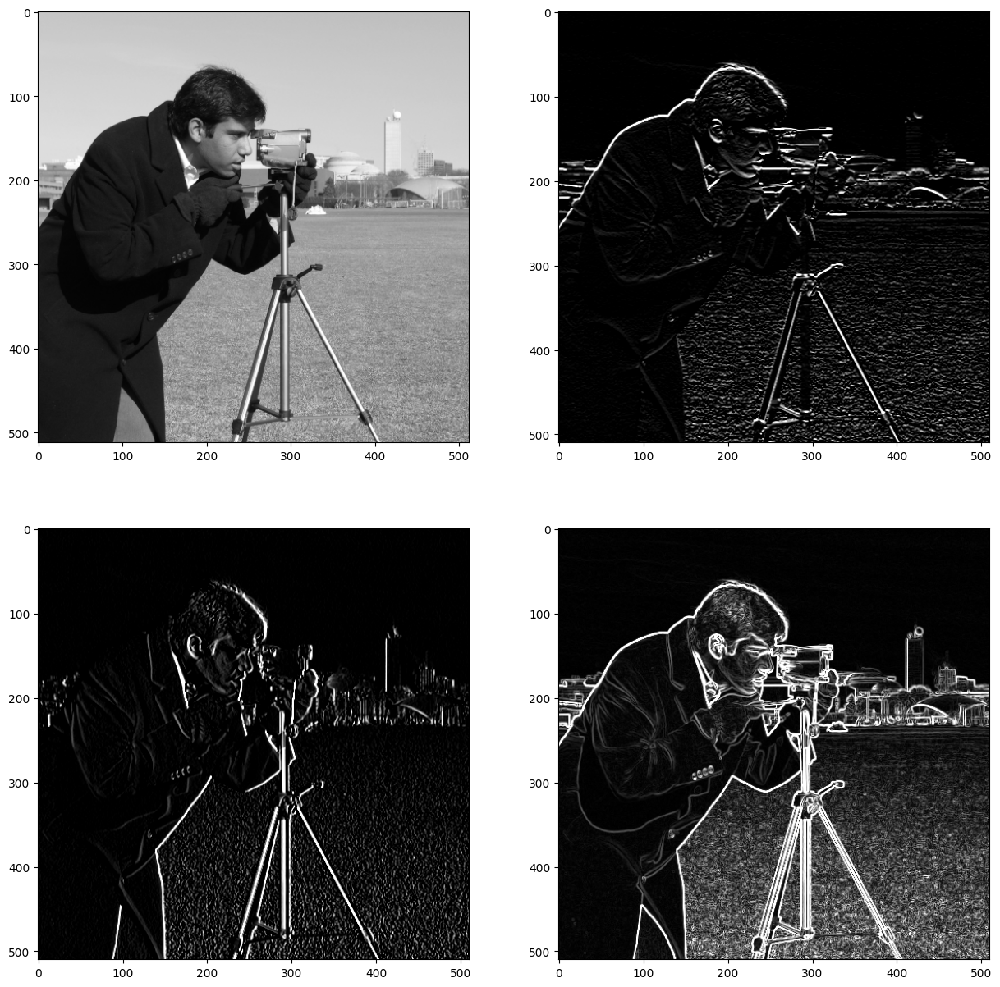

In [ ]:
camera = data.camera()
fig, axs = plt.subplots(2, 2, figsize=(15, 15))
axs[0, 0].imshow(camera, cmap="gray", vmin=0, vmax=255)
sobel_y_kernel = np.array([[ 1.0,  2.0, 1.0 ],
                               [ 0.0,  0.0, 0.0 ],
                               [-1.0, -2.0, -1.0]])
sobel_x_kernel = np.array([[ -1.0,  0.0, 1.0 ],
                           [ -2.0,  0.0, +2.0 ],
                           [-1.0, 0.0, 1.0]])

camera_horizontal = conv(camera,sobel_y_kernel,pad = 0)
camera_vertical = conv(camera,sobel_x_kernel,pad = 0)

axs[0, 1].imshow(camera_horizontal, cmap="gray", vmin=0, vmax=255)
axs[1, 0].imshow(camera_vertical, cmap="gray", vmin=0, vmax=255)
axs[1, 1].imshow(np.sqrt(camera_horizontal**2+camera_vertical**2), cmap="gray", vmin=0, vmax=255)

plt.show()

## Формат результата

Результатом являются 4 изображения, пример:

<img src ="https://edunet.kea.su/repo/EduNet-web_dependencies/dev-2.4/Exercises/EX06/result_1_task_ex06.png" width="500">


# Задание 2. Создание сверточной сети для  MNIST

Создайте сверточную сеть на PyTorch и обучите ее на MNIST.
* Используйте не более трёх [сверточных 🛠️[doc]](https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html) и не более двух [полносвязных 🛠️[doc]](https://pytorch.org/docs/stable/generated/torch.nn.Linear.html) слоев, а также [pooling-слои 🛠️[doc]](https://pytorch.org/docs/stable/generated/torch.nn.MaxPool2d.html) (слой pooling и аргумент `stride` у сверточных слоев помогут уменьшить число параметров линейного слоя).
* Не применяйте слои, которых не было в лекциях.
* Функцию активации выберите на свое усмотрение.
* Рекомендуется использовать код для обучения из задания №1 лекции №5. Для логирования используйте `SummaryWriter` из `torch.utils.tensorboard`
* Отладку кода рекомендуем производить на небольшой части датасета (как обычно).
* Используйте GPU. Для этого необходимо в верхней панели выбрать `Среда выполнения > Сменить среду выполнения` и заменить `CPU` на `T4 GPU`.

Импорт необходимых библиотек:

In [ ]:
import os
import torch
import torchmetrics
import numpy as np
import torch.nn as nn
import matplotlib.pyplot as plt

from tbparse import SummaryReader
from collections import defaultdict
from torch.nn.modules.pooling import MaxPool2d
from torch.utils.tensorboard import SummaryWriter
from torchvision import datasets, utils
from torchvision.transforms import v2
from IPython.display import clear_output

Нейронная сеть:

In [ ]:
class MnistCNN(nn.Module):
    def __init__(self,input_shape=(1,28,28)):
        super().__init__()
        self.kernel_sizes = [3,3,5]
        final_out_channels = 10
        output_size = [input_shape[1],input_shape[2]]
        self.conv1 = nn.Conv2d(in_channels = 1,out_channels=3,kernel_size = (self.kernel_sizes[0],self.kernel_sizes[0]))
        output_size = [output_size[0]-self.kernel_sizes[0]+1,output_size[1]-self.kernel_sizes[0]+1]
        self.conv2 = nn.Conv2d(in_channels = 3,out_channels = 5,kernel_size =(self.kernel_sizes[1],self.kernel_sizes[1]))
        output_size = [output_size[0]-self.kernel_sizes[1]+1,output_size[1]-self.kernel_sizes[1]+1]
        self.conv3 = nn.Conv2d(in_channels = 5,out_channels=final_out_channels,kernel_size = (self.kernel_sizes[2],self.kernel_sizes[2]))
        output_size = [output_size[0]-self.kernel_sizes[2]+1,output_size[1]-self.kernel_sizes[2]+1]
        self.pool = nn.MaxPool2d(kernel_size=(2,2))
        output_size = [output_size[0]//2,output_size[1]//2]
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(output_size[0]*output_size[1]*final_out_channels,100)
        self.fc2 = nn.Linear(100,10)
        self.activation = nn.ReLU()
    def forward(self, x):
        x = self.activation(self.conv1(x))
        x = self.activation(self.conv2(x))
        x = self.activation(self.conv3(x))
        x = self.pool(x)
        x = self.flatten(x)
        x = self.activation(self.fc1(x))
        scores  = self.fc2(x)
        return scores

Загрузите [MNIST 🛠️[doc]](https://pytorch.org/vision/stable/generated/torchvision.datasets.MNIST.html#torchvision.datasets.MNIST):

In [ ]:
from torch.utils.data import DataLoader

transform = v2.Compose(
    [
        v2.ToImage(),
        v2.ToDtype(torch.float32, scale=True),
    ]
)

mnist = datasets.MNIST(root="./", train=True, download=True, transform=transform)

(train_set, val_set,) = torch.utils.data.random_split(
    mnist, [50000, 10000], generator=torch.Generator().manual_seed(42)
)
test_set = datasets.MNIST(root="./", train=False, download=True, transform=transform)


raw_train_data = train_set.dataset.data[train_set.indices].numpy()
mnist_mean = np.mean(raw_train_data/255)
mnist_std = np.std(raw_train_data/255)

transform_with_normalize = v2.Compose(
    [v2.ToTensor(), v2.Normalize([mnist_mean],[mnist_std])])

train_set.dataset.transform = transform_with_normalize
val_set.dataset.transform = transform_with_normalize
test_set.transform = transform_with_normalize


batch_size = 256
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=False, num_workers=2)
train_loader =  DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=2)
test_loader = DataLoader(test_set, batch_size=batch_size, shuffle=False, num_workers=2)

/usr/local/lib/python3.11/dist-packages/torchvision/transforms/v2/_deprecated.py:42: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.Output is equivalent up to float precision.
  warnings.warn(


Напишите функции `train_loop()` и `val_loop()` для обучения и валидации ниже:

In [ ]:
def train_loop(dataloader, model, criterion, optimizer, score_function, device):
    model.train()
    one_ep_loss = 0
    one_ep_score = 0
    for imgs, labels in dataloader:
          optimizer.zero_grad()
          outputs = model(imgs.to(device))
          loss = criterion(outputs, labels.to(device))
          score = score_function(outputs, labels.to(device))
          loss.backward()
          optimizer.step()
          one_ep_score += score.item()
          one_ep_loss += loss.item()
    return one_ep_loss / len(dataloader),one_ep_score/len(dataloader)

In [ ]:
def val_loop(dataloader, model, criterion, optimizer, score_function, device):
    model.eval()
    one_ep_loss = 0
    one_ep_score = 0
    with torch.no_grad():
        for imgs, labels in dataloader:
            outputs = model(imgs.to(device))
            loss = criterion(outputs, labels.to(device))
            score = score_function(outputs, labels.to(device))
            one_ep_score += score.item()
            one_ep_loss += loss.item()
    return one_ep_loss / len(dataloader),one_ep_score/len(dataloader)

Предлагаем использовать `SummaryWriter` из `torch.utils.tensorboard` для логирования. Для создания директории для сохранения всех логов экспериментов внутри обучения можете использовать функцию `make_log_dir`:

In [ ]:
def make_log_dir(base_log_dir, exp_name):
    # Ensure base and experiment directories exist and make them if not
    os.makedirs(base_log_dir, exist_ok=True)

    exp_dir = os.path.join(base_log_dir, exp_name)
    os.makedirs(exp_dir, exist_ok=True)

    # Find the next version number
    version_num = 0
    for dirname in os.listdir(exp_dir):
        try:
            version_num = max(version_num, int(dirname.split("_")[-1]) + 1)
        except ValueError:
            continue

    # Create the new version directory
    version_dir = os.path.join(exp_dir, f"version_{version_num}")
    os.makedirs(version_dir)

    return version_dir

Напишите функцию `train`, внутри которой будут осуществляться циклы обучения и валидации,а также логироваться промежуточные значения метрик и функции потерь:

In [ ]:
def train(
    model,
    train_loader,
    val_loader,
    criterion,
    optimizer,
    score_function,
    device,
    num_epochs=10,
    base_log_dir="logs",
    exp_name="baseline",
):

    version_dir = make_log_dir(base_log_dir, exp_name)
    print(f"Logging process into {version_dir}")
    writer = SummaryWriter(version_dir)
    score_function_name = type(score_function).__name__

    for epoch in range(num_epochs):
        # Properly call train_loop and val_loop

        train_loss, train_score = train_loop(train_loader, model, criterion, optimizer, score_function, device)
        val_loss, val_score = val_loop(val_loader, model, criterion, optimizer, score_function, device)

        # Logging
        writer.add_scalar("Loss/train", train_loss, epoch)
        writer.add_scalar(f"{score_function_name}/train", train_score, epoch)

        writer.add_scalar("Loss/val", val_loss, epoch)
        writer.add_scalar(f"{score_function_name}/val", val_score, epoch)
        writer.flush()

    writer.close()

    return None

Задайте необходимые переменные для запуска обучения через функцию `train()` и обучите модель:

In [ ]:
from torchmetrics import Accuracy
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = MnistCNN().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
score_function = Accuracy(task="multiclass", num_classes=10).to(device)


train(model,train_loader,val_loader,criterion,optimizer,score_function,device)

Logging process into logs/baseline/version_1


Оценка результата на тестовой выборке:

In [ ]:
test_loss,test_score = val_loop(test_loader,model,criterion, optimizer, score_function, device)
print(f'Accuracy on test data {test_score:.2f}')

Accuracy on test data 0.99


Визуализируем логи обучения с помощью TensorBoard и tbparse аналогично тому, как мы делали в задании 1 к лекции 5.

Запустим TensorBoard, передав в параметр `--logdir` название директории с логами. В данном случае это `logs/ex06_task2/`:

In [ ]:
# Load the TensorBoard notebook extension, use once in a notebook
%load_ext tensorboard

In [ ]:
%tensorboard --logdir logs/baseline/version_3 --port 8000

<IPython.core.display.Javascript object>

Для визуализации с помощью tbparse соберем путь до директории с логами последней версии:

In [ ]:
def get_last_version_log_path(base_log_dir, exp_name):

    def extract_integer(path):
        return int(path.split(".")[0].split("_")[1])

    exp_dir = os.path.join(base_log_dir, exp_name)
    last_version = sorted(os.listdir(exp_dir), key=extract_integer)[-1]

    log_path = os.path.join(exp_dir, last_version)
    return log_path

base_log_dir = 'logs'
exp_name = 'baseline'
log_path = get_last_version_log_path(base_log_dir, exp_name)

print(f"Reading logs from {log_path}")

Reading logs from logs/baseline/version_1


Функция `tbparse_visual` читает логи с помощью `tbparse.SummaryReader`, парсит их и строит графики функции потерь и точности по эпохам с помощью matplotlib.

In [ ]:
def tbparse_visual(log_path):
    def collect_groups(df):
        tags = df["tag"].unique().tolist()
        groups = defaultdict(list)
        for tag in tags:
            if "/" in tag:
                group = tag[: tag.find("/")]
                groups[group].append(tag)
        return groups

    reader = SummaryReader(log_path)
    df = reader.scalars
    groups = collect_groups(df)
    for group in groups:
        plt.figure(figsize=(12, 4))
        for tag in groups[group]:
            tag_data = df.query("tag == @tag").sort_values(by="step")
            plt.plot(tag_data["step"], tag_data["value"], label=tag)
        plt.xlabel("epoch")
        plt.ylabel(f"{group}")
        plt.legend()
        plt.grid()
        plt.show()

    return None

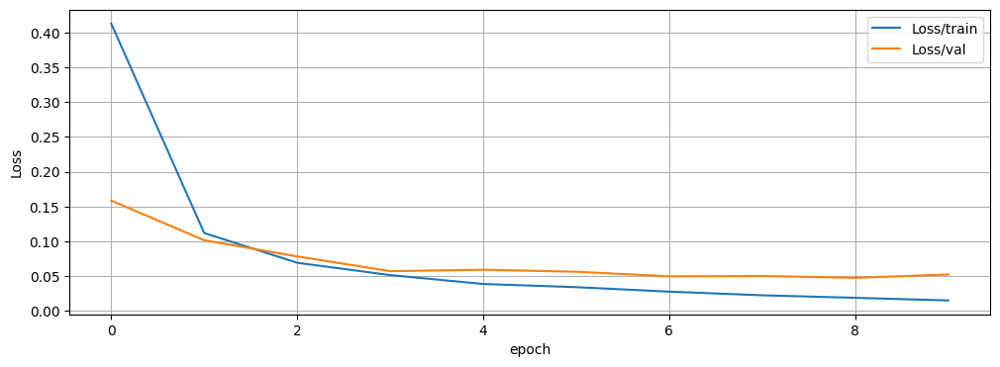

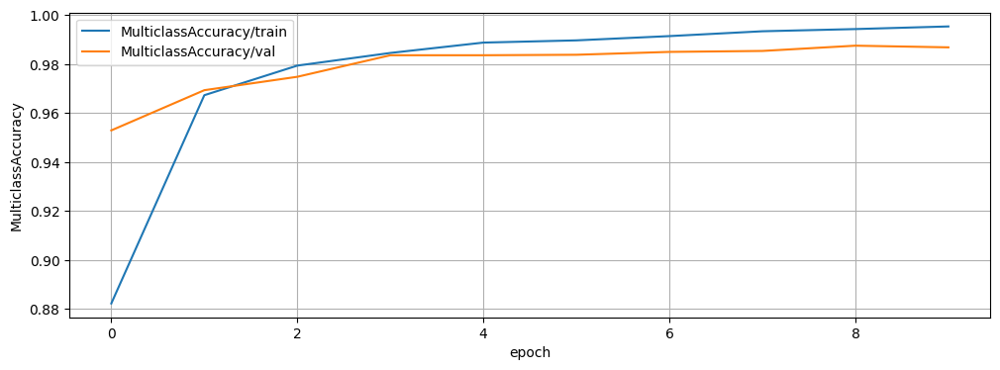

In [ ]:
tbparse_visual(log_path)

## Формат результата

Результатом является сверточная сеть, обученная на MNIST, с точностью не ниже 0.9

# Задание 3. Переход на Lightning

Для упрощения выполнения этого задания рекомендуем пользоваться блоками кода из [нашего блокнота-инструкции про Lightning 🥨[colab]](https://colab.research.google.com/drive/16Q_k7NR4oGMh5CrqErsdzWwpihlK4lbH#scrollTo=j10FAv-olwbU).

При обучении моделей в PyTorch нам постоянно приходится переписывать цикл обучения (train loop). Это дублирование кода, которое нарушает принцип [DRY 📚[wiki]](https://en.wikipedia.org/wiki/Don%27t_repeat_yourself).

Кроме того, нам нужно следить за процессом обучения модели. Например, если loss взрывается или выходит на плато, как правило, есть смысл остановить обучение. Чтобы контролировать этот процесс, приходится добавлять дополнительный код для вывода и/или логирования метрик.

При проведении реальных экспериментов логирование результатов станет необходимым. И в этом задании вы научитесь работать с фреймворком [Lightning 🛠️[doc]](https://lightning.ai/), который облегчает написание train loop, логирование результатов и.т.п.

Подзадачи:

1. Перепишите train loop из задания №2 с использованием фреймворка Lightning. Можете использовать наш [блокнот-инструкцию 🥨[colab]](https://colab.research.google.com/drive/16Q_k7NR4oGMh5CrqErsdzWwpihlK4lbH#scrollTo=j10FAv-olwbU).
2. Выберите один из [инструментов для работы с логами 🛠️[doc]](https://lightning.ai/docs/pytorch/stable/extensions/logging.html), который поддерживат Lightning. Можете использовать наш блокнот про [TensorBoard 🥨[colab]](https://colab.research.google.com/drive/1-RkUgYJPGyg3ZJ_Z7b4jRALVToicgpCZ).
3. Обучите модель из второго задания. В процессе обучения сохраняйте в лог значения `accuracy/train`, `accuracy/val` и `loss/train` на каждой эпохе.
4. Выведите графики метрик, собранных во время выполнения п.3.


Можно использовать пакет [torchmetrics 🛠️[doc]](https://torchmetrics.readthedocs.io/en/stable/).

[[doc] 🛠️ Дополнительная информация про логирование метрик](https://lightning.ai/docs/pytorch/stable/extensions/logging.html#automatic-logging)

Импорт необходимых библиотек:

In [ ]:
import torch
import torchmetrics
import lightning as L
import torch.nn as nn
import matplotlib.pyplot as plt

from torchmetrics import MetricCollection
from torchmetrics.classification import (
    MulticlassAccuracy,
    MulticlassF1Score,
    MulticlassAUROC,
)
from torch import optim
from torch.nn.modules.pooling import MaxPool2d
from torchvision import datasets, utils
from torchvision.transforms import v2
from lightning.pytorch.callbacks import ModelCheckpoint

### Код LightningModule

Этим кодом мы заменим наш train loop из второго задания. Ваша задача — дописать недостающий код.

In [ ]:
class LModel(L.LightningModule):
    def __init__(self, model, lr=0.001):
        super().__init__()
        self.save_hyperparameters(logger=False, ignore=["model"])
        self.lr = lr
        self.model = model
        self.criterion = nn.CrossEntropyLoss()

        metrics = MetricCollection([
            MulticlassAccuracy(num_classes=10,),
            MulticlassF1Score(num_classes=10,),
            MulticlassAUROC(num_classes=10,)
        ])
        self.train_metrics = metrics.clone(postfix="/train")
        self.val_metrics = metrics.clone(postfix="/val")
        self.test_metrics = metrics.clone(postfix="/test")

    def configure_optimizers(self):

        optimizer = torch.optim.AdamW(
            self.model.parameters(),
            lr=self.lr,
        )
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
            optimizer,
        )
        return {
            "optimizer": optimizer,
            "lr_scheduler": {
                "scheduler": scheduler,
                "interval": "epoch",
                "monitor": "loss"
            },
        }

    def training_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss = self.criterion(out, y)
        self.train_metrics.update(out, y)
        self.log("loss", loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        self.val_metrics.update(out, y)

    def on_train_epoch_end(self):
        self.log_dict(self.train_metrics.compute())
        self.train_metrics.reset()

        val_metrics = self.val_metrics.compute()
        self.log_dict(val_metrics)
        self.val_metrics.reset()

    def test_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        self.test_metrics.update(out, y)

    def on_test_epoch_end(self):
        self.log_dict(self.test_metrics.compute())
        self.test_metrics.reset()


### Подготовка датасета

In [ ]:
transform = v2.Compose( [
    v2.ToImage(),
    v2.ToDtype(torch.float32, scale=True),

]
)

mnist = datasets.MNIST(root="./", train=True, download=True, transform=transform)
test_set = datasets.MNIST(root="./", train=False, download=True, transform=transform)

train_set, val_set, _ = torch.utils.data.random_split(mnist, [10000, 3000, 47000])

raw_train_data = train_set.dataset.data[train_set.indices].numpy()
mnist_mean = np.mean(raw_train_data/255)
mnist_std = np.std(raw_train_data/255)

transform_with_normalize = v2.Compose(
    [v2.ToTensor(), v2.Normalize([mnist_mean],[mnist_std])])

train_set.dataset.transform = transform_with_normalize
val_set.dataset.transform = transform_with_normalize
test_set.transform = transform_with_normalize


batch_size = 256
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=False, num_workers=2)
train_loader =  DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=2)
test_loader = DataLoader(test_set, batch_size=batch_size, shuffle=False, num_workers=2)

/usr/local/lib/python3.11/dist-packages/torchvision/transforms/v2/_deprecated.py:42: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.Output is equivalent up to float precision.
  warnings.warn(


### Запуск Tensorboard

По умолчанию Lightning иcпользует [Tensorboard 🐾[git]](https://github.com/Gan4x4/ml_snippets/blob/main/Training/Tensorboard.ipynb).

[[colab] 🥨 Наш ознакомительный блокнот с TensorBoard](https://colab.research.google.com/drive/1-RkUgYJPGyg3ZJ_Z7b4jRALVToicgpCZ#scrollTo=DGkBwvykm_Ci).


In [ ]:
# colab magic command, run only once
%reload_ext tensorboard

Попробуем его запустить:

In [ ]:
# %reload_ext tensorboard

%tensorboard --logdir logs/ex3 --port 6007

<IPython.core.display.Javascript object>

Совет: запускайте TensorBoard до обучения, чтобы отслеживать прогресс. Используйте для разных заданий разные порты и папки с логами.

TensorBoard не всегда корректно открывается в colab. Если вы видите в окне выше ошибку, используйте другой логгер, например [WandB 🛠️[doc]](https://lightning.ai/docs/pytorch/stable/extensions/generated/lightning.pytorch.loggers.WandbLogger.html#lightning.pytorch.loggers.WandbLogger).

Запустим обучение модели: TensorBoard можно обновлять и следить за обучением.

In [ ]:
# Your code here

L.seed_everything(42)

model = MnistCNN()

pl_model = LModel(model)

logger=L.pytorch.loggers.TensorBoardLogger(save_dir="./logs/ex3/")
# checkpoint_callback = ModelCheckpoint(
#     monitor="MulticlassAccuracy/val", mode="max", filename="model"
# )

trainer = L.Trainer(
    max_epochs=10,
    # callbacks=[checkpoint_callback],
    num_sanity_val_steps=0,
    log_every_n_steps=10,
    logger=logger
)

trainer.fit(
    model=pl_model,
    train_dataloaders=train_loader,
    val_dataloaders=val_loader
)

INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42
INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name          | Type             | Params | Mode 
-----------------------------------------------------------
0 | model         | MnistCNN         | 102 K  | train
1 | criterion     | CrossEntropyLoss | 0      | train
2 | train_metrics | MetricCollection | 0      | train
3 | val_metrics   | MetricCollection | 0      | train
4 | test_metrics  | MetricCollection | 0      | train
--------------------------

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=10` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


Полученные логи можно конвертировать в pandas при помощи [tbparse 🐾[git]](https://github.com/j3soon/tbparse) и отобразить, используя matplotlib.

Чтобы получить таблицу, где названия метрик соответствуют названиям столбцов, используем параметр `pivot=True`.

In [ ]:
from tbparse import SummaryReader

log_dir = trainer.logger.experiment.get_logdir()  # lightning_logs/version_x

reader = SummaryReader(log_dir, pivot=True)
df = reader.scalars
df.head()

,step,MulticlassAUROC/train,MulticlassAUROC/val,MulticlassAccuracy/train,MulticlassAccuracy/val,MulticlassF1Score/train,MulticlassF1Score/val,epoch,loss
0,9,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.698078
1,19,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.725875
2,29,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.552378
3,39,0.946442,0.987327,0.719381,0.863027,0.719736,0.859434,"[0.0, 0.0]",0.621493
4,49,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.321204


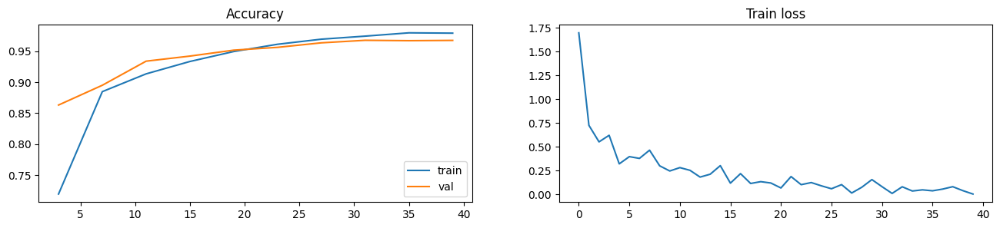

In [ ]:
plt.figure(figsize=(16, 3))


def drop_nan(df, tag):
    return df[~df[tag].isna()].loc[:, tag]


plt.subplot(1, 2, 1).set_title("Accuracy")

plt.plot(drop_nan(df, "MulticlassAccuracy/train"), label="train")
plt.plot(drop_nan(df, "MulticlassAccuracy/val"), label="val")
plt.legend(loc="lower right")

plt.subplot(1, 2, 2).set_title("Train loss")
plt.plot(drop_nan(df, "loss"))
plt.show()

In [ ]:
trainer.test(pl_model,dataloaders=test_loader)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   MulticlassAUROC/test    │    0.9994603991508484     │
│  MulticlassAccuracy/test  │    0.9732968807220459     │
│  MulticlassF1Score/test   │    0.9731177091598511     │
└───────────────────────────┴───────────────────────────┘

[{'MulticlassAccuracy/test': 0.9732968807220459,
  'MulticlassF1Score/test': 0.9731177091598511,
  'MulticlassAUROC/test': 0.9994603991508484}]

## Формат результата

Результатом является график, отрисованный при помощи выбранного вами инструмента. Пример:

<img src ="https://edunet.kea.su/repo/EduNet-web_dependencies/dev-2.4/Exercises/EX06/result_3_task_ex06.png" width="800">


# Задание 4. Собственные аугментации

В этом задании предлагается применить к датасету CIFAR-10 аугментации и визуализировать получившиеся результаты. Требуется воспользоваться готовыми аугментациями из `torchvision.transforms.v2`, а также реализовать собственный метод для аугментации изображений.

Импорт необходимых библиотек:

In [ ]:
import torchvision
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets
from torchvision.transforms import v2

Функция для вывода изображений:

In [ ]:
def show_images(dataset, tag, img_count=32):
    """
    Helper method to display first img_count images from dataset
    """

    loader = DataLoader(dataset, batch_size=img_count)

    # Get first batch from dataloader
    dataiter = iter(loader)
    images, labels = next(dataiter)

    # Create grid of images
    img_grid = torchvision.utils.make_grid(images)

    # Plot
    plt.figure(figsize=(10, 7))
    plt.imshow(img_grid.permute((1, 2, 0)))
    plt.title(tag)
    plt.axis("off")
    plt.show()

Загрузите CIFAR-10 и:

* выберите два преобразования из [списка 🛠️[doc]](https://pytorch.org/vision/stable/transforms.html),
* примените их к изображениям из датасета,
* выведите измененные изображения.

100%|██████████| 170M/170M [00:03<00:00, 44.8MB/s]


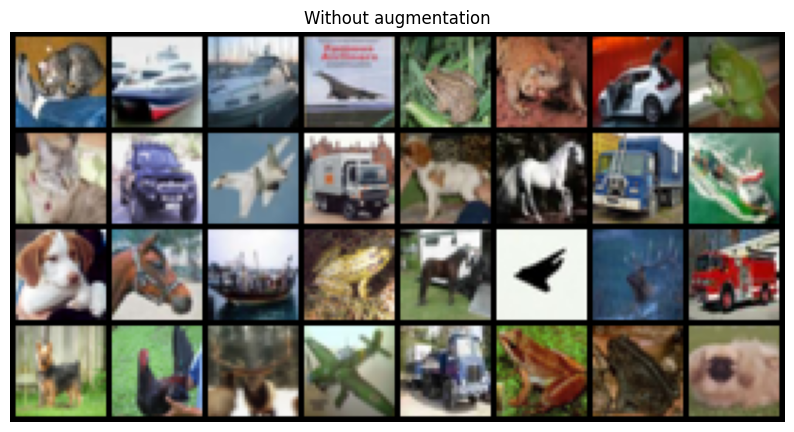

In [ ]:
test_set = datasets.CIFAR10(
    "content",
    train=False,
    transform=v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)]),
    download=True,
)

show_images(test_set, "Without augmentation")

/usr/local/lib/python3.11/dist-packages/torchvision/transforms/v2/_deprecated.py:42: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.Output is equivalent up to float precision.
  warnings.warn(


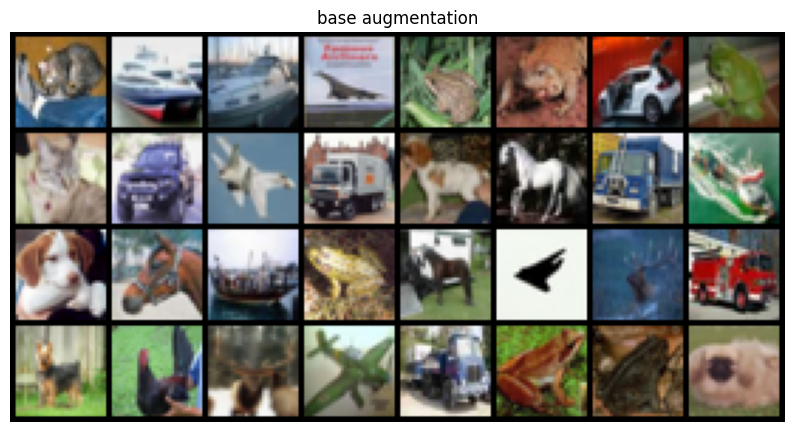

In [ ]:
base_augmentation = v2.Compose(
    [
        v2.ToTensor(),
        v2.RandomHorizontalFlip(0.5),
        v2.RandomRotation(np.pi/4)
    ]
)

test_set.transform = base_augmentation
show_images(test_set, "base augmentation")

## Создание собственной аугментации

* Создайте собственную аугментацию, которой нет в `torchvision.transforms.v2`. Например, сделайте изображение квадратным при помощи padding, или обнулите часть пикселей, или уменьшите изображение и затем восстановите его до прежнего размера ...

* Выведите измененные изображения. При использовании функции `show_images` обратите внимание, что список трансформаций должен содержать `transforms.v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.

/usr/local/lib/python3.11/dist-packages/torchvision/transforms/v2/_deprecated.py:42: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.Output is equivalent up to float precision.
  warnings.warn(


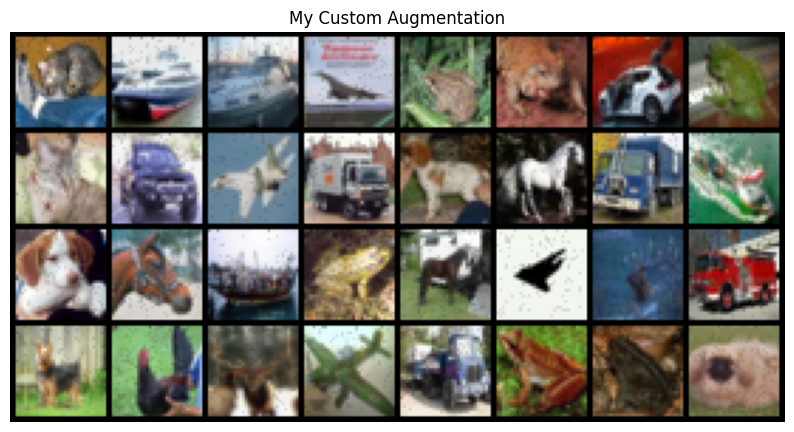

In [ ]:
class MyCustomTransform(torch.nn.Module):
    def __init__(self,p,coef):
      super().__init__()
      self.p = p
      self.coef = coef
    def forward(self, img):
        np_image = img.numpy()
        np_image = np_image.transpose(1,2,0)
        ind_to_change = np.random.choice(
            a=[True, False], size=np_image.shape[:2], p=[self.p, 1 - self.p]
        )
        inds = np.where(ind_to_change == True)
        inds = np.transpose(inds)
        for ind in inds:
          try:
            np_image[ind[0]][ind[1]] = self.coef*(np_image[ind[0]-1][ind[1]]+np_image[ind[0]+1][ind[1]]+np_image[ind[0]][ind[1]+1]+np_image[ind[0]][ind[1]-1])/4
          except(IndexError):
            continue
        np_image = np_image.transpose(2,0,1)
        return torch.tensor(np_image)

custom_augmentation = v2.Compose(
    [
        v2.ToTensor(),
        MyCustomTransform(0.1,0.9)
    ]
)

test_set.transform = custom_augmentation
show_images(test_set, "My Custom Augmentation")

## Формат результата

Выведенные изображения:
* без аугментаций,
* с двумя аугментациями из torchvision,
* со своей собственной аугментацией.

# Задание 5. Создание сверточной сети для CIFAR-10

Создайте сверточную сеть на PyTorch и обучите ее на СIFAR-10. Цель — получить лучшее качество, чем у полносвязной сети, которую мы обучали в 5-й лекции.

* Используйте не более трёх [сверточных 🛠️[doc]](https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html) и не более двух [полносвязных 🛠️[doc]](https://pytorch.org/docs/stable/generated/torch.nn.Linear.html) слоев, а также [pooling-слои 🛠️[doc]](https://pytorch.org/docs/stable/generated/torch.nn.MaxPool2d.html) (слой pooling и аргумент `stride` у сверточных слоев помогут уменьшить число параметров линейного слоя).
* Не применяйте слои, которых не было в лекциях.
* Функцию активации выберите на свое усмотрение.
* Допустимо применить аугментации к входным данным.

Импорт необходимых библиотек:

In [ ]:
import torch
import torchmetrics
import torch.nn as nn
import lightning as L

from torch import optim
from torchvision import datasets
from torchsummary import summary
from torch.nn.modules.pooling import MaxPool2d
from torchvision import datasets, utils
from torchvision.transforms import v2

Завершите реализацию модели:

In [ ]:
class CifarCNN(nn.Module):
    def __init__(self,init_shape = (3,32,32)):
        super().__init__()
        kernel_sizes = [3,3,3,3]
        final_out_channels = 25
        out_size = [init_shape[1],init_shape[2]]
        self.conv1 = nn.Conv2d(in_channels = init_shape[0],out_channels = 7,kernel_size = (kernel_sizes[0],kernel_sizes[0]))
        out_size = [out_size[0]-kernel_sizes[0]+1,out_size[1]-kernel_sizes[0]+1]
        self.conv2 = nn.Conv2d(in_channels = 7,out_channels = 15,kernel_size = (3,3))
        out_size =  [out_size[0]-kernel_sizes[1]+1,out_size[1]-kernel_sizes[1]+1]
        self.pool1 = nn.MaxPool2d(kernel_size = (2,2))
        out_size = [out_size[0]//2,out_size[1]//2]
        self.conv3 = nn.Conv2d(in_channels = 15,out_channels = 20,kernel_size = (3,3))
        out_size = [out_size[0]-kernel_sizes[2]+1,out_size[1]-kernel_sizes[2]+1]
        self.conv4 = nn.Conv2d(in_channels = 20,out_channels = final_out_channels,kernel_size = (3,3))
        out_size = [out_size[0]-kernel_sizes[3]+1,out_size[1]-kernel_sizes[3]+1]
        self.pool2 = nn.MaxPool2d(kernel_size = (2,2))
        out_size = [out_size[0]//2,out_size[1]//2]
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(out_size[0]*out_size[1]*final_out_channels,100)
        self.fc2 = nn.Linear(100,10)
        self.activation = nn.ReLU()
    def forward(self, x):
        x = self.activation(self.conv1(x))
        x = self.activation(self.conv2(x))
        x = self.pool1(x)
        x = self.activation(self.conv3(x))
        x = self.activation(self.conv4(x))
        x = self.pool2(x)
        x = self.flatten(x)
        x = self.activation(self.fc1(x))
        x = self.fc2(x)
        return x

In [ ]:
from torchsummary import summary

model = CifarCNN()
model.cpu()
summary(model, (3, 32, 32), device="cpu")

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 7, 30, 30]             196
              ReLU-2            [-1, 7, 30, 30]               0
            Conv2d-3           [-1, 15, 28, 28]             960
              ReLU-4           [-1, 15, 28, 28]               0
         MaxPool2d-5           [-1, 15, 14, 14]               0
            Conv2d-6           [-1, 20, 12, 12]           2,720
              ReLU-7           [-1, 20, 12, 12]               0
            Conv2d-8           [-1, 25, 10, 10]           4,525
              ReLU-9           [-1, 25, 10, 10]               0
        MaxPool2d-10             [-1, 25, 5, 5]               0
          Flatten-11                  [-1, 625]               0
           Linear-12                  [-1, 100]          62,600
             ReLU-13                  [-1, 100]               0
           Linear-14                   

Загрузите CIFAR-10:

In [ ]:
from torchvision.datasets import CIFAR10
from torch.utils.data import random_split
transform = v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])

train_val_data = CIFAR10(
    root="./CIFAR10", train=True, download=True, transform=transform
)
train_data, val_data = random_split(train_val_data, lengths=[40000, 10000])

test_data = CIFAR10(root="./CIFAR10", train=False, download=True, transform=transform)

100%|██████████| 170M/170M [00:05<00:00, 33.8MB/s]


In [ ]:
raw_train_data = train_data.dataset.data[train_data.indices]
cifar10_mean = np.mean(raw_train_data/255, axis=(0,1,2))
cifar10_std = np.std(raw_train_data/255, axis=(0,1,2))

In [ ]:
transform_with_normalize = v2.Compose(
    [v2.ToTensor(), v2.Normalize(cifar10_mean,cifar10_std)])

train_data.dataset.transform = transform_with_normalize
val_data.dataset.transform = transform_with_normalize
test_data.transform = transform_with_normalize
batch_size = 256
cifar_train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True, num_workers=2)
cifar_val_loader = DataLoader(val_data, batch_size=batch_size, shuffle=False, num_workers=2)
cifar_test_loader = DataLoader(test_data, batch_size=batch_size, shuffle=False, num_workers=2)

/usr/local/lib/python3.11/dist-packages/torchvision/transforms/v2/_deprecated.py:42: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.Output is equivalent up to float precision.
  warnings.warn(


In [ ]:
%reload_ext tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/ex5 --port 6008

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6008 (pid 7182), started 0:00:37 ago. (Use '!kill 7182' to kill it.)

<IPython.core.display.Javascript object>

Совет: используйте `lr=0.001`.

Разместите код для обучения в этом блоке:

In [ ]:
class LModel(L.LightningModule):
    def __init__(self, model, lr=0.001):
        super().__init__()
        self.save_hyperparameters(logger=False, ignore=["model"])
        self.lr = lr
        self.model = model
        self.criterion = nn.CrossEntropyLoss()

        metrics = MetricCollection([
            MulticlassAccuracy(num_classes=10,),
            MulticlassF1Score(num_classes=10,),
            MulticlassAUROC(num_classes=10,)
        ])
        self.train_metrics = metrics.clone(postfix="/train")
        self.val_metrics = metrics.clone(postfix="/val")
        self.test_metrics = metrics.clone(postfix="/test")

    def configure_optimizers(self):

        optimizer = torch.optim.AdamW(
            self.model.parameters(),
            lr=self.lr,
        )
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
            optimizer,
        )
        return {
            "optimizer": optimizer,
            "lr_scheduler": {
                "scheduler": scheduler,
                "interval": "epoch",
                "monitor": "loss"
            },
        }

    def training_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss = self.criterion(out, y)
        self.train_metrics.update(out, y)
        self.log("loss", loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        self.val_metrics.update(out, y)

    def on_train_epoch_end(self):
        self.log_dict(self.train_metrics.compute())
        self.train_metrics.reset()

        val_metrics = self.val_metrics.compute()
        self.log_dict(val_metrics)
        self.val_metrics.reset()

    def test_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        self.test_metrics.update(out, y)

    def on_test_epoch_end(self):
        self.log_dict(self.test_metrics.compute())
        self.test_metrics.reset()


In [ ]:
L.seed_everything(42)

model = CifarCNN()
cifar_lit_model = LModel(model,lr=0.001)

logger=L.pytorch.loggers.TensorBoardLogger(save_dir="./logs/ex5/")


trainer = L.Trainer(
    max_epochs=10,
    num_sanity_val_steps=0,
    log_every_n_steps=10,
    logger=logger
)


INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42
INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer.fit(
    model=cifar_lit_model,
    train_dataloaders=cifar_train_loader,
    val_dataloaders=cifar_val_loader,
)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name          | Type             | Params | Mode 
-----------------------------------------------------------
0 | model         | CifarCNN         | 72.0 K | train
1 | criterion     | CrossEntropyLoss | 0      | train
2 | train_metrics | MetricCollection | 0      | train
3 | val_metrics   | MetricCollection | 0      | train
4 | test_metrics  | MetricCollection | 0      | train
-----------------------------------------------------------
72.0 K    Trainable params
0         Non-trainable params
72.0 K    Total params
0.288     Total estimated model params size (MB)
24        Modules in train mode
0         Modules in eval mode
INFO:lightning.pytorch.callbacks.model_summary:
  | Name          | Type             | Params | Mode 
-----------------------------------------------------------
0 | model         | CifarCNN         | 72.0 K | train
1 | crite

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7d18888ad580>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1618, in __del__
    self._shutdown_workers()Exception ignored in: 
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1601, in _shutdown_workers
    if w.is_alive():<function _MultiProcessingDataLoaderIter.__del__ at 0x7d18888ad580>
  
 Traceback (most recent call last):
   File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1618, in __del__
    self._shutdown_workers()
   File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1601, in _shutdown_workers
    if w.is_alive():
       ^^^ ^ ^^^^^^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
^    ^assert self._parent_pid == os.getpid(), 'can only test a child process'
 ^
   File "/usr/lib/pyth

Validation: |          | 0/? [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7d18888ad580>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1618, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1601, in _shutdown_workers
    if w.is_alive():
       ^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
       Exception ignored in:  <function _MultiProcessingDataLoaderIter.__del__ at 0x7d18888ad580>
  Traceback (most recent call last):
   File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1618, in __del__
^^^    ^^^self._shutdown_workers()
^  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1601, in _shutdown_workers
^    ^if w.is_alive():^
^ ^ ^  ^   ^^^^^^^^^^^

Validation: |          | 0/? [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7d18888ad580><function _MultiProcessingDataLoaderIter.__del__ at 0x7d18888ad580>
Traceback (most recent call last):

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1618, in __del__
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1618, in __del__
        self._shutdown_workers()self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1601, in _shutdown_workers

      File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1601, in _shutdown_workers
if w.is_alive():
       if w.is_alive():
         ^ ^^ ^^^^^^^^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
^    ^assert self._parent_pid == os.getpid(), 'can only test a child process'

  File "/usr/lib/python

Validation: |          | 0/? [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7d18888ad580>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1618, in __del__
Exception ignored in:     <function _MultiProcessingDataLoaderIter.__del__ at 0x7d18888ad580>
Traceback (most recent call last):
self._shutdown_workers()  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1618, in __del__

      File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1601, in _shutdown_workers
self._shutdown_workers()    if w.is_alive():

  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1601, in _shutdown_workers
     if w.is_alive(): 
           ^^ ^^^^^^^^^^^^^^^^^^^^^
^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
        assert self.

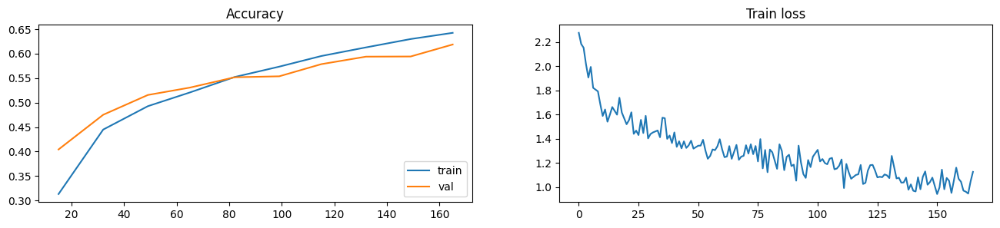

In [ ]:
log_dir = trainer.logger.experiment.get_logdir()
reader = SummaryReader(log_dir, pivot=True)
df = reader.scalars
plt.figure(figsize=(16, 3))


def drop_nan(df, tag):
    return df[~df[tag].isna()].loc[:, tag]


plt.subplot(1, 2, 1).set_title("Accuracy")

plt.plot(drop_nan(df, "MulticlassAccuracy/train"), label="train")
plt.plot(drop_nan(df, "MulticlassAccuracy/val"), label="val")
plt.legend(loc="lower right")

plt.subplot(1, 2, 2).set_title("Train loss")
plt.plot(drop_nan(df, "loss"))
plt.show()


## Оценка результата на тестовой выборке

In [ ]:
# Load the best checkpoint automatically (lightning tracks this for you)
trainer.test(
    model=cifar_lit_model, dataloaders=cifar_test_loader, verbose=True, ckpt_path="best"
)

INFO: Restoring states from the checkpoint path at ./logs/ex5/lightning_logs/version_0/checkpoints/epoch=9-step=1570.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at ./logs/ex5/lightning_logs/version_0/checkpoints/epoch=9-step=1570.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at ./logs/ex5/lightning_logs/version_0/checkpoints/epoch=9-step=1570.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at ./logs/ex5/lightning_logs/version_0/checkpoints/epoch=9-step=1570.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   MulticlassAUROC/test    │     0.932671844959259     │
│  MulticlassAccuracy/test  │    0.6194000244140625     │
│  MulticlassF1Score/test   │    0.6148263216018677     │
└───────────────────────────┴───────────────────────────┘

[{'MulticlassAccuracy/test': 0.6194000244140625,
  'MulticlassF1Score/test': 0.6148263216018677,
  'MulticlassAUROC/test': 0.932671844959259}]

## Формат результата

Результатом является сверточная сеть, обученная на CIFAR-10, с точностью не ниже 0.6